# Projet 7: Implémentez un modèle de scoring (suivi de la performance)

Le "drift" est un terme utilisé dans le Machine Learning pour décrire la façon dont les **performances d'un modèle en production se dégradent lentement au fil du temps**.

Le "drift" peut représenter un **vrai problème** dans le monde réel où les données sont en général dynamiques et changent en permanence. En effet, les modèles de ML sont construits à partir de données historiques mais une fois qu'ils sont utilisés dans le monde réel, ils peuvent devenir obsolètes et perdre leur précision au fil du temps car les propriétés statistiques des données en entrée ont changé.

Il existe plusieurs raisons pour lesquelles un modèle de ML peut dériver au fil du temps. La raison la plus courante est que les données sur lesquelles le modèle a été formé deviennent obsolètes et ne représentent plus les conditions actuelles:
- la **distribution** des données a changé
- la **relation** entre les variables en entrée (X) et la cible (y) ont changé.

*Exemple: un modèle de ML est conçu pour prédire le cours de l'action de l'entreprise Prêt à Dépenser. Ce modèle a été créé à partir des données historiques de l'entreprise. Si le marché est stable, les résultats peuvent être assez performants. En revanche, si le marché est plus volatile, le modèle ne pourra plus prédire avec précision le cours de l'action, les propriétés statistiques ayant changé.*

De plus, aucun modèle ne peut éviter totalement le "drift" car ils ne gèrent pas toujours très bien les changements dans les données. 

Il existe 2 types principaux de drift:
- **concept drift ou model drift**: la tâche pour laquelle le modèle a été conçu change au fil du temps. *Par exemple, un modèle est conçu pour détecter des fraudes dans les notes de frais sur la base de leur montant et récurrence. Si le modèle a été entrainé sur un historique de notes de frais basés sur une politique de l'entreprise restrictive en termes de dépenses et favorisant les échanges à distance et que d'un coup la politique de dépenses change et encourage ses commerciaux à voyager et inviter les clients à déjeuner par exemple, le modèle ne pourra plus détecter avec précision les notes de frais frauduleuses.*

Le concept drif peut être divisé en 4 catégories (Learning under Concept Drift: A Review, Jie Lu et al.):

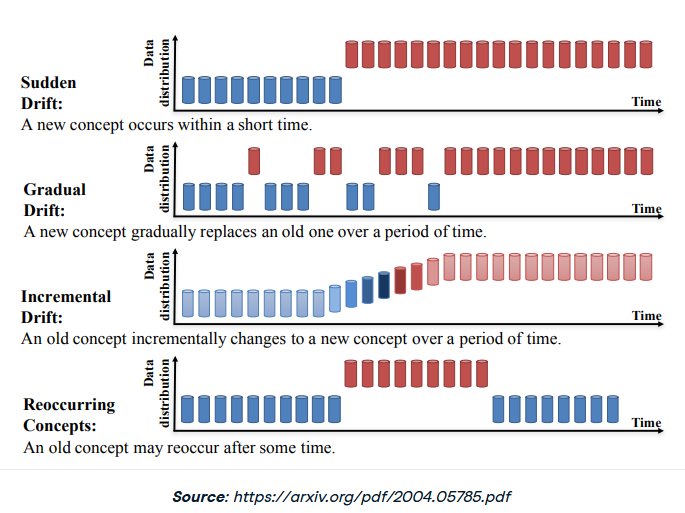

- **Data drift**: la distribution des données d'entrée change au fil du temps. *Par exemple, un modèle prédit le risque de défaillance d'un client en fonction de son âge, de son revenu et de son type d'emploi. Si la distribution des âges, revenus et emplois change significativement au fil du temps, le modèle peut ne plus être en mesure de prédire avec précision le risque de défaillance du client.*

Il est important de prendre des mesures pour **prévenir et amoindrir les effets du drift**:
- il faut contrôler et évaluer en continu les performances du modèle
- mettre à jour le modèle à l'aide de nouvelles données
- utiliser des modèles plus résistants à la dérive

Voici quelques exemples de tests permettant de détecter le data drift:
- **Test de Kolmogorov-Smirnov**: test statistique non paramétrique utilisé pour déterminer si deux ensembles de données proviennent de la même distribution. Il est souvent utilisé pour vérifier si un échantillon de données provient d'une population spécifique ou pour comparer deux échantillons afin de déterminer s'ils proviennent de la même population. L'hypothèse nulle de ce test est que les distributions sont identiques. Si cette hypothèse est rejetée, cela suggère qu'il y a une dérive dans le modèle.
- **Indice de stabilité de la population**: mesure statistique utilisée pour comparer la distribution d'une variable catégorielle dans deux ensembles de données différents. Une valeur élevée de l'ISP indique qu'il existe une différence significative entre les distributions de la variable dans les deux ensembles de données, ce qui peut suggérer une dérive du modèle.

Si la distribution d'une variable a changé de manière significative, ou si plusieurs variables ont changé dans une certaine mesure, il peut être nécessaire de **recalibrer ou de reconstruire le modèle pour améliorer ses performances**.
- la méthode **Page-Hinkley** est une méthode statistique utilisée pour détecter les changements de la moyenne d'une série de données dans le temps. Elle est couramment utilisée pour contrôler les performances des modèles d'apprentissage automatique et détecter les changements dans la distribution des données qui peuvent indiquer une dérive du modèle.

Nous allons utiliser la librairie **evidently** pour détecter s'il y a du data drift en production dans le futur. Nous allons prendre comme hypothèse que le dataset application_train représente les données pour la modélisation et le dataset application_test, les données de nouveaux clients une fois le modèle en production.

Le rappport evidently sur le data drift **compare les distributions de chaque variable dans les deux datasets** (application_train et application_test). Le **test statitique** (ou la métrique appropriée) est automatiquement choisi en fonction du **type des données** et de leur **volume** et retourne les p-values ou distances et trace les distributions. Les tests statistiques ou palliers peuvent être ajustés manuellement.

## Table des matières: <a class="anchor" id="0"></a>

1. [Import des librairies](#library)
2. [Chargement des données et mapping](#load)
    1. [Données de référence](#data_ref)
    2. [Données actuelles](#data_actual)
    3. [Mapping](#map)
3. [Tableau d'analyse du data drift](#datadrift)

## Import des librairies <a class="anchor" id="library"></a>

In [1]:
# Data
import pandas as pd

# Fonctions personnelles
import fct_eda
import fct_preprocessing
import fct_model

# Update Fonctions personnelles
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

# Data drift
from evidently import ColumnMapping
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset

## Chargement des données et mapping <a class="anchor" id="load"></a>

Les données de **référence** sont les données utilisées pour l'apprentissage du modèle (ou des données de production antérieures). Ici nous prendrons comme données de référence le dataset application_train.

Le dataset application_test, représente quant à lui les **données de nouveaux clients** une fois le modèle en production.

### Données de référence <a class="anchor" id="data_ref"></a>

In [2]:
# Données de rérérence
application_train = fct_preprocessing.preprocessing_no_NaN()

Application_train shape: (307505, 64)
Processing application_train fait en 10.0s 
Bureau shape: (305811, 19)
Processing bureau et bureau_balance fait en 28.0s 
Previous applications shape: (338857, 150)
Processing previous_applications fait en 60.0s 
Pos-cash balance shape: (337252, 3)
Processing POS-CASH balance fait en 10.0s 
Installments payments shape: (339587, 4)
Processing installments payments fait en 24.0s 
Credit card balance shape: (103558, 5)
Processing credit card balance fait en 97.0s 


In [3]:
fct_eda.shape_total_nan(application_train)

Nombre de lignes: 307505
Nombre de colonnes: 240
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%


In [4]:
# Features du modèle
feat_lgb30 = ['CREDIT_DURATION', 'EXT_SOURCE_2', 'INSTAL_DAYS_PAST_DUE_MEAN',
              'PAYMENT_RATE', 'POS_CNT_INSTALMENT_FUTURE_MEAN', 'CREDIT_GOODS_PERC',
              'AGE', 'POS_NB_CREDIT', 'BURO_CREDIT_ACTIVE_Active_SUM', 'BURO_AMT_CREDIT_SUM_DEBT_MEAN',
              'YEARS_EMPLOYED', 'YEARS_ID_PUBLISH', 'INSTAL_PAYMENT_DIFF_MEAN', 'BURO_AMT_CREDIT_SUM_MEAN',
              'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'BURO_YEARS_CREDIT_ENDDATE_MEAN', 'AMT_CREDIT',
              'YEARS_LAST_PHONE_CHANGE', 'POS_MONTHS_BALANCE_MEAN', 'INSTAL_DAYS_BEFORE_DUE_MEAN',
              'BURO_AMT_CREDIT_SUM_DEBT_SUM', 'CODE_GENDER', 'PREV_YEARS_DECISION_MEAN',
              'REGION_POPULATION_RELATIVE', 'DEBT_RATIO', 'BURO_AMT_CREDIT_SUM_SUM',
              'BURO_YEARS_CREDIT_ENDDATE_MAX', 'NAME_EDUCATION_TYPE',
              'PREV_PAYMENT_RATE_MEAN']

In [5]:
# Transformation du dataset pour correspondre aux données utilisées dans le modèle
app_train_drift = application_train[feat_lgb30]
app_train_drift = app_train_drift[app_train_drift['NAME_EDUCATION_TYPE'] == 'Lower Secondary & Secondary']
app_train_drift, categ_feat = fct_eda.categories_encoder(app_train_drift, nan_as_category=False)
app_train_drift.rename(columns={'NAME_EDUCATION_TYPE': 'NAME_EDUCATION_TYPE_Lower Secondary & Secondary'}, inplace=True)

In [6]:
app_train_drift.head()

,CREDIT_DURATION,EXT_SOURCE_2,INSTAL_DAYS_PAST_DUE_MEAN,PAYMENT_RATE,POS_CNT_INSTALMENT_FUTURE_MEAN,CREDIT_GOODS_PERC,AGE,POS_NB_CREDIT,BURO_CREDIT_ACTIVE_Active_SUM,BURO_AMT_CREDIT_SUM_DEBT_MEAN,...,INSTAL_DAYS_BEFORE_DUE_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,CODE_GENDER,PREV_YEARS_DECISION_MEAN,REGION_POPULATION_RELATIVE,DEBT_RATIO,BURO_AMT_CREDIT_SUM_SUM,BURO_YEARS_CREDIT_ENDDATE_MAX,NAME_EDUCATION_TYPE_Lower Secondary & Secondary,PREV_PAYMENT_RATE_MEAN
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100002,16.461104,0.262949,0.000000,0.060749,15.000000,1.158397,26.0,19.0,2.0,30722.62500,...,20.421053,245781.00,1,1.660000,0.018801,0.121978,865055.565,2.94,0,0.051670
100004,20.000000,0.555912,0.000000,0.050000,2.250000,1.000000,52.0,4.0,0.0,0.00000,...,7.666667,0.00,1,2.230000,0.010032,0.100000,189037.800,1.63,0,0.266450
100006,10.532818,0.650442,0.000000,0.094941,8.571429,1.052803,52.0,21.0,2.0,34978.51125,...,19.375000,169017.75,0,0.748889,0.008019,0.219900,961677.000,3.43,0,0.046203
100007,23.461618,0.322738,0.954545,0.042623,8.969697,1.000000,55.0,66.0,0.0,0.00000,...,4.590909,0.00,1,3.350000,0.028663,0.179963,146250.000,2.15,0,0.090659
100008,17.824857,0.354225,37.628571,0.056101,4.108434,1.079198,46.0,83.0,1.0,80019.00000,...,11.514286,240057.00,1,3.264000,0.035792,0.277955,468445.500,2.34,0,0.094444


### Données actuelles <a class="anchor" id="data_actual"></a>

In [7]:
# Données actuelles
application_test = fct_preprocessing.preprocessing_no_NaN_app_test()

Application_test shape: (48744, 63)
Processing application_test fait en 2.0s 
Bureau shape: (305811, 19)
Processing bureau et bureau_balance fait en 30.0s 
Previous applications shape: (338857, 150)
Processing previous_applications fait en 92.0s 
Pos-cash balance shape: (337252, 3)
Processing POS-CASH balance fait en 16.0s 
Installments payments shape: (339587, 4)
Processing installments payments fait en 40.0s 
Credit card balance shape: (103558, 5)
Processing credit card balance fait en 30.0s 


In [8]:
fct_eda.shape_total_nan(application_test)

Nombre de lignes: 48744
Nombre de colonnes: 239
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%


In [9]:
# Features du modèle
feat_lgb30 = ['CREDIT_DURATION', 'EXT_SOURCE_2', 'INSTAL_DAYS_PAST_DUE_MEAN',
              'PAYMENT_RATE', 'POS_CNT_INSTALMENT_FUTURE_MEAN', 'CREDIT_GOODS_PERC',
              'AGE', 'POS_NB_CREDIT', 'BURO_CREDIT_ACTIVE_Active_SUM', 'BURO_AMT_CREDIT_SUM_DEBT_MEAN',
              'YEARS_EMPLOYED', 'YEARS_ID_PUBLISH', 'INSTAL_PAYMENT_DIFF_MEAN', 'BURO_AMT_CREDIT_SUM_MEAN',
              'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'BURO_YEARS_CREDIT_ENDDATE_MEAN', 'AMT_CREDIT',
              'YEARS_LAST_PHONE_CHANGE', 'POS_MONTHS_BALANCE_MEAN', 'INSTAL_DAYS_BEFORE_DUE_MEAN',
              'BURO_AMT_CREDIT_SUM_DEBT_SUM', 'CODE_GENDER', 'PREV_YEARS_DECISION_MEAN',
              'REGION_POPULATION_RELATIVE', 'DEBT_RATIO', 'BURO_AMT_CREDIT_SUM_SUM',
              'BURO_YEARS_CREDIT_ENDDATE_MAX', 'NAME_EDUCATION_TYPE',
              'PREV_PAYMENT_RATE_MEAN']

In [10]:
# Transformation du dataset pour correspondre aux données utilisées dans le modèle
app_test_drift = application_test[feat_lgb30]
app_test_drift = app_test_drift[app_test_drift['NAME_EDUCATION_TYPE'] == 'Lower Secondary & Secondary']
app_test_drift, categ_feat = fct_eda.categories_encoder(app_test_drift, nan_as_category=False)
app_test_drift.rename(columns={'NAME_EDUCATION_TYPE': 'NAME_EDUCATION_TYPE_Lower Secondary & Secondary'}, inplace=True)

In [11]:
app_test_drift.head()

,CREDIT_DURATION,EXT_SOURCE_2,INSTAL_DAYS_PAST_DUE_MEAN,PAYMENT_RATE,POS_CNT_INSTALMENT_FUTURE_MEAN,CREDIT_GOODS_PERC,AGE,POS_NB_CREDIT,BURO_CREDIT_ACTIVE_Active_SUM,BURO_AMT_CREDIT_SUM_DEBT_MEAN,...,INSTAL_DAYS_BEFORE_DUE_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,CODE_GENDER,PREV_YEARS_DECISION_MEAN,REGION_POPULATION_RELATIVE,DEBT_RATIO,BURO_AMT_CREDIT_SUM_SUM,BURO_YEARS_CREDIT_ENDDATE_MAX,NAME_EDUCATION_TYPE_Lower Secondary & Secondary,PREV_PAYMENT_RATE_MEAN
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100005,12.824870,0.291656,0.111111,0.077973,7.181818,1.2376,49.0,11.0,2.0,189469.500000,...,23.666667,568408.500,1,1.465,0.035792,0.175455,657126.000,0.35,0,0.059935
100028,32.130726,0.509677,0.265487,0.031123,10.129032,1.0000,38.0,31.0,5.0,15525.375000,...,3.265487,186304.500,0,3.078,0.026392,0.155614,1520875.080,5.10,0,0.079129
100038,19.506034,0.425687,0.000000,0.051266,5.846154,1.0000,36.0,13.0,2.0,39808.623068,...,12.250000,207099.000,1,1.275,0.010032,0.178150,1090813.455,3.51,0,0.083990
100042,27.736247,0.628904,0.192308,0.036054,13.492308,1.1848,51.0,65.0,8.0,219583.063929,...,6.307692,3074162.895,0,4.990,0.025164,0.128150,9540657.000,4.46,0,0.068420
100074,26.525199,0.660015,0.250000,0.037700,5.000000,1.0000,65.0,22.0,0.0,0.000000,...,8.600000,0.000,0,6.010,0.003122,0.377000,360974.520,4.84,0,0.111100


### Mapping <a class="anchor" id="map"></a>

Evidently s'attend à une certaine structure de jeu de données et à des noms de colonnes en entrée et recommande de spécifier manuellement le mapping des colonnes.

In [12]:
# Structure du dataset: spécifier le nom des colonnes

column_mapping = ColumnMapping()

#column_mapping.target = 'y' # colonne à prédire, non utile ici (app_test ne contient pas cette colonne)
#column_mapping.prediction = 'pred' # colonne de prédiction, non utile ici
column_mapping.id = None # l'ID est en index
#column_mapping.datetime = 'date' # pas de colonnes au format date

In [13]:
# Les variables catégorielles étant one hot encodées, toutes les features sont numériques
column_mapping.numerical_features = app_test_drift.columns.tolist()

## Tableau d'analyse du data drift <a class="anchor" id="datadrift"></a>

Nous allons utiliser un rapport regroupant les metrics pertinents pour évaluer le data drift. Ce rapport va **comparer les distributions des variables du modèle entre les données actuelles et la référence** et va mettre en évidence les variables qui ont dérivé. 

In [14]:
report = Report(metrics=[
    DataDriftPreset(), 
])

report.run(reference_data=app_train_drift, current_data=app_test_drift)
report.show(mode='inline')

Sur les 30 features de notre modèle de scoring, **7** features montrent du data drift (soit **23.33%** du nombre total de features):
- PAYMENT_RATE
- CREDIT_DURATION
- AMT_GOODS_PRICE
- AMT_CREDIT
- AMT_ANNUITY
- YEARS_LAST_PHONE_CHANGE
- PREV_PAYMENT_RATE_MEAN

Cela signifie que la **distribution des données en entrée du modèle vs celle des données actuelles a changé au fil du temps**.

Comme les données catégorielles ont été encodées à l'aide de la méthode OneHot, toutes les features du dataset sont désormais numériques. Le test utilisé est donc la **distance de Wasserstein (normalisée)** (WD). Il s'agit de la méthode par défaut pour les données tabulaires numériques supérieures à 1000 lignes. Le data drift est détecté lorsque la distance (drift score) est supérieure à 0.1 (seuil par défaut). 

WD mesure l'**effort nécessaire pour transformer une distribution en une autre**. Si le data drift se produit dans une direction (toutes les valeurs augmentent ou diminuent), la valeur absolue est souvent égale à la différence des moyennes. Mais si certaines valeurs augmentent et d'autres diminuent, appliquer la différence des moyennes reviendrait à "annuler" les changements, il faut donc les additionner. De plus, afin de pouvoir comparer des features avec des unités différentes, les valeurs absolues sont transformées en valeurs **relatives** en **divisant la valeur absolue par l'écart type**.

WD normalisée indique donc le nombre d'écarts types en moyenne qu'il faudrait déplacer pour chaque ID du groupe actuel pour qu'il corresponde au groupe de référence.

Le seuil de détection du data drift de 0.1 signifie donc qu'un **changement dans la taille des écarts-types de 0.1 est significatif**.

Dans l'ensemble, cette mesure est un **bon compromis** entre le test de Kolmogorov-Smirnov beaucoup trop sensible et le test de la divergence de Jensen-Shannon et l'indice de stabilité de population qui ne remarquent que les gros changements.

Voici quelques pistes pour gérer le data drift du modèle en production:
- **vérifier la qualité des données**: le mieux est de mettre en place des contrôles distincts concernant la qualité et l'intégrité des données. Il est possible de récupérer les données à la source, résoudre des éventuels problèmes de logs, mettre à jour le code de transformation des features etc. Dans ce cas, il ne sert à rien de réentrainer le modèle qui est bon, ce sont les données qui ne le sont pas.
- **enquêter sur le data drift**: tracer les distributions des variables qui ont dérivé, collaborer avec les experts métier, vérifier qu'il ne s'agit pas de concept drift (relations entre les features ou entre les features et la target qui ont changé), retracer la matrice de corrélation.
- **laisser tel quel**: on décide que le data drift n'est pas assez significatif. Il faut se fier au jugement du datascientist connaissant les données et le use case. On peut également décider d'attendre car les données seront bientôt labellisées ou mettre en place des rapports et alertes supplémentaires ou encore être satisfait de la manière dont le modèle réagit au data drift.
- **réentrainer le modèle**: c'est la solution la plus simple mais possible que lorsqu'il est possible d'obtenir les nouveaux labels.
- **calibrer ou reconstruire le modèle**: plutôt que le répéter le pipeline total du modèle lors du réentrainement, il peut être plus judicieux de reconstruire le modèle: modifier les étapes de preprocessing, de sélection de variables, de choix d'hyperparamètres... A partir du moment où les labels sont disponibles, il est possible d'analyser les performances du modèle et de choisir la meilleure méthode. Il est également possible d'accorder plus d'importance aux échantillons récents ou créer un modèle spécifique pour les segments qui échouent. Si le modèle ne nous satisfait toujours pas en termes de performances, il peut être nécessaire de se baser sur la connaissance métier ou encore la compréhension des relations causales.
- **interrompre le modèle / utiliser une solution de repli**: pour des erreurs risquées et coûteuses, mieux vaut ne pas utiliser un modèle peu performant. Il est par exemple possible de masquer les recommandations faites, de s'appuyer sur le jugement d'un expert, mettre en place un ensemble de règles moins précises mais plus robustes etc
- **identifier les segments peu performants**: le data drift peut parfois n'affecter qu'un segment de la population, il peut être nécessaire de limiter le modèle pour certaines données sans le stopper complètement.
- **mettre la logique métier au dessus du modèle**: les experts métiers et ML s'entendent pour corriger manuellement la sortie, définir un nouveau seuil de décision pour les problèmes de classification, traiter les valeurs aberrantes ou encore détecter les données qui sont très différentes pour être traitées manuellement.

https://docs.evidentlyai.com/